# Extract Forest Health Data


In [2]:
# Libraries and Functions
import os
import sys
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns

from shapely.geometry import Point
from pyprojroot import here

sys.path.insert(0, "../../src")
from utilities import *

## User Input


In [ ]:
my_buffer_in_meters = 1000

## Load Forest Health Data


In [3]:
raw_fh = pd.read_excel(
    here("data/raw/forest_health/forest_health_2007_2023.xlsx"),
    sheet_name="signalement0",
    skiprows=2,
    header=0,
)

In [4]:
# Get df
df_fh = raw_fh.copy()

# Rename columns
df_fh = df_fh.rename(
    {
        "X Lambert 93": "lon_fr",
        "Y Lambert 93": "lat_fr",
        "Longitude": "lon",
        "Latitude": "lat",
        "Date d'observation": "date",
        "Année d'observation": "year",
        "Département": "dep",
        "LIB_Essence dominante": "dominant_species_fr",
        "LIB_Essence concernée": "affected_species_fr",
        "LIB_Essence regroupée (ess. concernée)": "affected_genus_fr",
        "Pourcentage de tiges atteintes": "percentage_stems_affected",
        "Sévérité": "severity",
        "LIB_Type de problème": "problem_type",
        "Type de problème": "problem_type_code",
    },
    axis=1,
)

# Subset colummns
df_fh = df_fh[
    [
        "lon_fr",
        "lat_fr",
        "lon",
        "lat",
        "date",
        "year",
        "dep",
        # "dominant_species_fr", # Drop because adds duplicates and is not usable for analysis
        # "affected_species_fr", # Also causes duplicates
        "affected_genus_fr",
        "percentage_stems_affected",
        "severity",
        "problem_type",
        "problem_type_code",
    ]
]

# Convert french species names into latin
species_dict = {
    "Douglas": "Pseudotsuga",
    "Chênes": "Quercus",
    "Peupliers": "Populus",
    "Châtaignier": "Castanea",
    "Pins": "Pinus",
    "Aulnes": "Alnus",
    "Épicéas": "Picea",
    "Hêtre": "Fagus",
    "Cèdres": "Cedrus",
    "Sapins": "Abies",
    "Bouleaux": "Betula",
    "Charme": "Carpinus",
    "Mélèzes": "Larix",
    "Fruitiers": "Fruittrees",  # Refers to various species of fruit trees
    "Autres résineux": "Conifers",  # Refers to various species of other conifers
    "Autres feuillus": "Broadleaves",  # Refers to various species of other broadleaves
    "Frênes": "Fraxinus",
    "Saules": "Salix",
    "Tremble": "Populus",  # Aspen is a type of Poplar
    "Noyers": "Juglans",
    "Ormes": "Ulmus",
    "Érables": "Acer",
    "Taxodiacées": "Taxodium",  # Example from the Taxodiaceae family
    "Tilleuls": "Tilia",
    np.nan: "Various",  # Non-declared species added to the "Various" category
}

# Replace species names
df_fh["affected_genus_lat"] = df_fh["affected_genus_fr"]
df_fh["affected_genus_lat"] = df_fh["affected_genus_lat"].replace(species_dict)

# Lambert 93 Coordinates are 100x too small in excel file
# TODO : Check if this is a bug in the excel file. Ask Arthur...
# Going via the lat/lon columns is a workaround
# df_fh.lon_fr = df_fh.lon_fr * 100
# df_fh.lat_fr = df_fh.lat_fr * 100

# Attach geometry
df_fh = gpd.GeoDataFrame(
    df_fh,
    geometry=gpd.points_from_xy(df_fh.lon, df_fh.lat),
    crs="EPSG:4326",
).to_crs("EPSG:2154")

df_fh.head()

# Drop duplicates
# - Sometimes, the same impact has been reported multiple times
# - This causes issues! But which one to keep?
# - For now, we ignore reportings from subsequent years
# - But for the current year, we keep the most severe one

df_fh = df_fh.sort_values("percentage_stems_affected", ascending=False).drop_duplicates(
    keep="first"
)

# Save to file
df_fh.to_file(
    here("data/tmp/france_data/forest_health.geojson"),
    driver="GeoJSON",
)

In [5]:
# A few statistics
print("Number of observations in the raw data:", len(raw_fh))
print("Number of unique observations in the raw data:", len(raw_fh.drop_duplicates()))
print("Number of observations:", len(df_fh))
print("Number of unique observations:", len(df_fh.drop_duplicates()))

Number of observations in the raw data: 73306
Number of unique observations in the raw data: 73306
Number of observations: 53191
Number of unique observations: 53191


<Axes: xlabel='lon_fr', ylabel='lat_fr'>

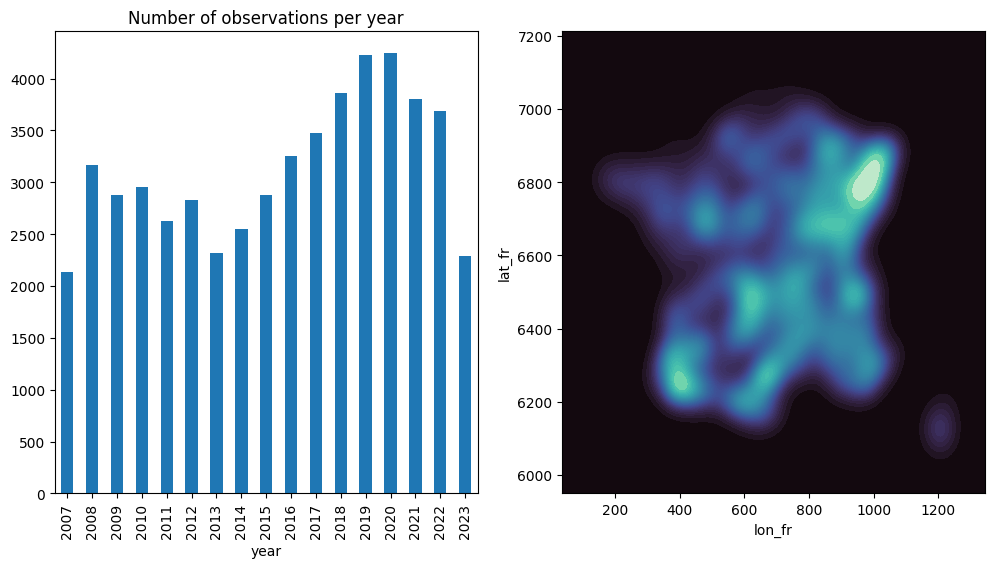

In [6]:
# Figures
fig, axs = plt.subplots(1, 2, figsize=(12, 6))

df_fh["year"].value_counts().sort_index().plot(
    kind="bar", title="Number of observations per year", ax=axs[0]
)
# Heatmap of observations
sns.kdeplot(
    data=df_fh,
    x="lon_fr",
    y="lat_fr",
    fill=True,
    thresh=0,
    levels=50,
    cmap="mako",
    ax=axs[1],
)

/var/folders/39/534x_msj7sl1kcxj2mg109x40000gn/T/ipykernel_26560/140863297.py:14: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


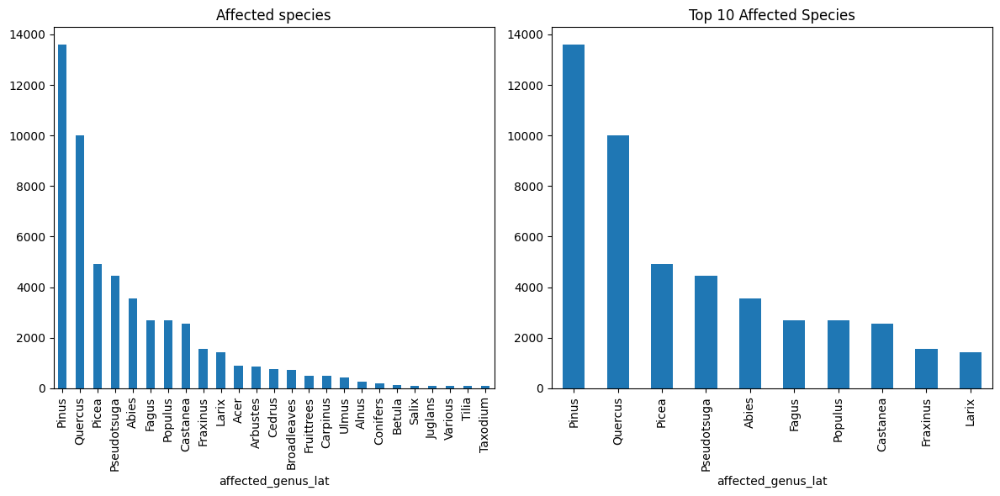

In [7]:
import seaborn as sns

fig, axs = plt.subplots(1, 2, figsize=(12, 6))

df_fh["affected_genus_lat"].value_counts(dropna=False).plot(
    kind="bar", title="Affected species", ax=axs[0]
)

top_10_genus_lat = df_fh["affected_genus_lat"].value_counts(dropna=False).nlargest(10)
top_10_list = top_10_genus_lat.index.tolist()
top_10_genus_lat.plot(kind="bar", title="Top 10 Affected Species", ax=axs[1])

fig.tight_layout()
fig.show()

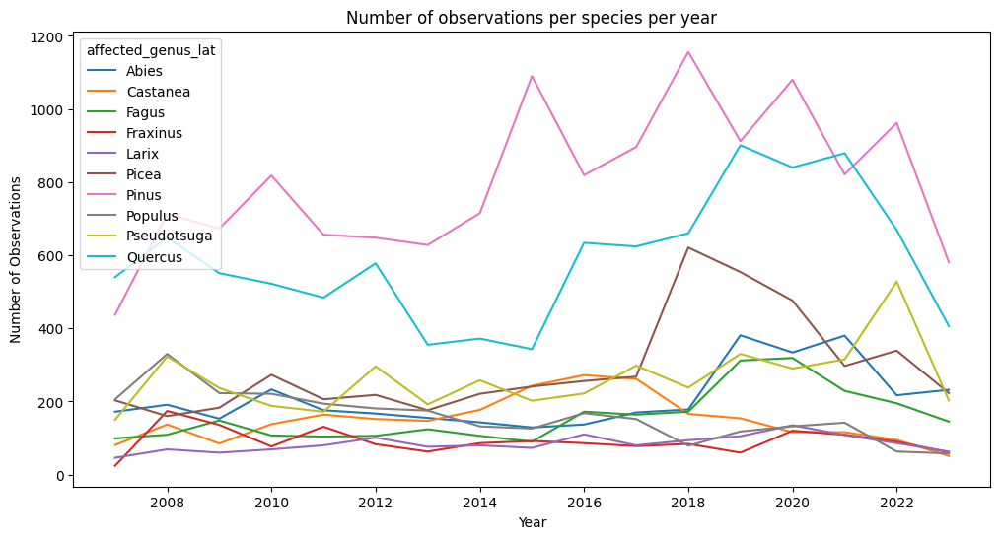

In [8]:
# Count the observations per genus_lat per year
df_counts = (
    df_fh.query("affected_genus_lat in @top_10_list")
    .groupby(["year", "affected_genus_lat"])
    .size()
    .reset_index()
    .rename(columns={0: "count"})
)

# Create the plot
plt.figure(figsize=(12, 6))
sns.lineplot(data=df_counts, x="year", y="count", hue="affected_genus_lat")

# Set the title and labels
plt.title("Number of observations per species per year")
plt.xlabel("Year")
plt.ylabel("Number of Observations")

# Show the plot
plt.show()

## Load NFI Sites


In [9]:
# Get site coordinates
site_coordinates = pd.read_csv("../00_process_nfi_data/nfi_final_sites_with_idp.csv")
df_sites = site_coordinates.copy()[["idp", "x_fr", "y_fr", "first_year"]]
df_sites = df_sites.rename({"first_year": "year"}, axis=1)
df_sites = gpd.GeoDataFrame(
    df_sites,
    geometry=gpd.points_from_xy(df_sites.x_fr, df_sites.y_fr),
    crs="EPSG:2154",
)

# Attach a circle polygon of 700m radius to each site
df_sites["geometry"] = df_sites.buffer(my_buffer_in_meters)

display(df_sites.head())
print(f"Number of sites: {len(df_sites)}")

,idp,x_fr,y_fr,year,geometry
0,632691,267415.027897,6.820144e+06,2011,"POLYGON ((268415.028 6820144.094, 268410.213 6..."
1,702597,726971.216676,6.566524e+06,2012,"POLYGON ((727971.217 6566524.426, 727966.401 6..."
2,706240,727562.508709,6.636462e+06,2012,"POLYGON ((728562.509 6636462.487, 728557.693 6..."
3,708321,507027.573495,6.792198e+06,2012,"POLYGON ((508027.573 6792197.871, 508022.758 6..."
4,708369,981009.515199,6.248657e+06,2012,"POLYGON ((982009.515 6248656.607, 982004.700 6..."


## Detect Disturbance Per Site


In [10]:
df_out = pd.DataFrame()
df_in = df_sites

# Loop through every site-year
for i in tqdm(range(1, df_in.shape[0])):
    # Get site and year
    site = df_in.iloc[i].idp
    year = df_in.iloc[i].year

    # Filter df_fh for all points that fall into the site polygon
    df_fh_site = df_fh[df_fh.within(df_in.iloc[i].geometry)]
    # Filter df_fh_site for all points that fall into +/- 5 years of the year
    df_fh_site_year = df_fh_site.query(f"{year} - 5 <= year <= {year} + 5")
    # Extract information falling into buffer zone
    df_loop = df_fh_site_year.copy().reset_index(drop=True)
    df_loop["idp"] = site
    df_loop["idp_year"] = year
    df_out = pd.concat([df_out, df_loop], axis=0)

# Move idp and year to the front
df_out.insert(0, "idp", df_out.pop("idp"))
df_out.insert(0, "idp_year", df_out.pop("idp_year"))

100%|██████████| 41295/41295 [03:39<00:00, 188.40it/s]


In [14]:
# Attach severity scaled (could be done above but easier to do here for now)
df_out["severity_scaled"] = df_out["severity"] * df_out["percentage_stems_affected"]
# Check final df
df_out

,idp_year,idp,lon_fr,lat_fr,lon,lat,date,year,dep,affected_genus_fr,percentage_stems_affected,severity,problem_type,problem_type_code,affected_genus_lat,geometry,severity_scaled
0,2012,702597,727.1070,6567.244,3.35157,46.2045,2016-08-16,2016,3,Chênes,90,3,Dégât d'origine pathologique,P,Quercus,POINT (727107.837 6567244.095),270
1,2012,702597,726.9050,6567.065,3.34893,46.2029,2016-05-24,2016,3,Chênes,80,3,Dégât d'origine entomologique,E,Quercus,POINT (726905.066 6567065.512),240
0,2012,708369,980.9870,6247.771,6.46033,43.2737,2017-09-08,2017,83,Chênes,100,1,Dégât d'origine entomologique,E,Quercus,POINT (980987.276 6247771.238),100
0,2012,713058,958.7520,6397.313,6.26289,44.6268,2015-03-08,2015,5,Mélèzes,100,1,Dégât d'origine abiotique,Q,Larix,POINT (958752.915 6397313.986),100
0,2012,728213,502.8670,6760.940,0.36028,47.9192,2011-08-09,2011,72,Pins,60,2,Dégât d'origine pathologique,P,Pinus,POINT (502867.341 6760940.633),120
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1,2016,1102817,634.0080,6262.196,2.18500,43.4558,2013-10-03,2013,81,Douglas,1,3,Dégât d'origine pathologique,P,Pseudotsuga,POINT (634008.914 6262196.130),3
0,2016,1110464,1019.7830,6297.433,6.96806,43.7036,2017-05-12,2017,6,Chênes,20,1,Dégât d'origine entomologique,E,Quercus,POINT (1019783.501 6297433.185),20
0,2016,1119712,856.3680,6552.862,5.02278,46.0575,2019-04-17,2019,1,Épicéas,90,4,Dégât d'origine entomologique,E,Picea,POINT (856368.231 6552862.207),360
0,2016,1121312,345.1510,6295.932,-1.40127,43.6734,2019-12-02,2019,40,Pins,1,4,Dégât d'origine pathologique,P,Pinus,POINT (345151.778 6295932.261),4


### Data Exploration


<Axes: ylabel='Frequency'>

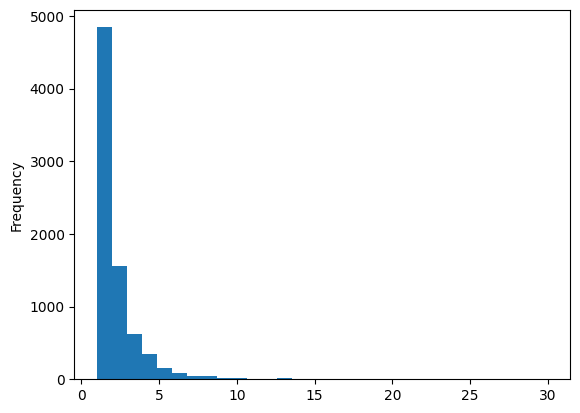

In [15]:
# How many observation per site?
df_out["idp"].value_counts().plot(kind="hist", bins=30)

## Extract Metrics


**What metrics do I want?**

- For tplus5 and tminus5:
  - For all species and for the most dominant species (link dominant species from nfi code to latin code)
    - Number of recorded incidents
    - Total severity
    - Total severity scaled by percentage of affected stems


In [13]:
def extract_fh_metrics(idp_in, df_in):
    # Input df: Observations per site per 5 years before or after census (adding suffix done outside)
    # df_in = df_out.query("idp == 1105651")
    # Extract general metrics, no species subset
    # Metrics: Number of observations, sum of severity, sum of severity*percentage_stems_affected

    if df_in.shape[0] == 0:
        return pd.DataFrame(
            {
                "idp": idp_in,
                "fh_nObsAll": 0,
                "fh_severityAll": 0,
                "fh_severityScaledAll": 0,
            },
            index=[0],
        )

    metrics_general = (
        df_in.groupby("idp")
        .agg({"idp_year": "count", "severity": "sum", "severity_scaled": "sum"})
        .reset_index()
    )
    metrics_general.columns = [
        "idp",
        "fh_nObsAll",
        "fh_severityAll",
        "fh_severityScaledAll",
    ]

    return metrics_general

In [42]:
# Set species variable that determines dominance
# ! Note: Only works for espar_red for now.
species_variable_of_interest = "espar_red"
# Set spatial aggregation variable
# ! Note: Only works for idp for now. The others would need additional code to calculate per-year.
spatial_variable_of_interest = "idp"
# Load raw data
nfi_raw = pd.read_feather(here("data/tmp/nfi/nfi_ready_for_analysis.feather"))
nfi_raw.shape

(549255, 194)

In [43]:
# Aggregate data to chosen spatial variable and extract the most dominant species, based on ba_1
# Create list of idp-groups
nfi_grouped = split_df_into_list_of_group_or_ns(nfi_raw, spatial_variable_of_interest)

In [45]:
# For every group, calculate the most dominant species based on sum of ba_1
def apply_this(group, spatial_variable_of_interest, species_variable_of_interest):
    x = (
        group.groupby([spatial_variable_of_interest, species_variable_of_interest])
        .agg({"ba_1": "sum"})
        .sort_values("ba_1", ascending=False)
        .reset_index()
        .head(1)
    )

    return x


# Test on one group
display(
    apply_this(
        nfi_grouped[0], spatial_variable_of_interest, species_variable_of_interest
    )
)

# Apply to all groups
nfi_grouped = pd.concat(
    [
        apply_this(group, spatial_variable_of_interest, species_variable_of_interest)
        for group in tqdm(nfi_grouped)
    ]
)
display(nfi_grouped.head())

,idp,espar_red,ba_1
0,500002,3,85.032385


100%|██████████| 40231/40231 [00:50<00:00, 799.65it/s]


,idp,espar_red,ba_1
0,500002,3,85.032385
0,500008,3,5.113477
0,500012,2,44.075525
0,500013,17,32.592188
0,500042,3,49.129021


In [47]:
# Get species dictionary
species_dict = (
    nfi_raw[["espar_red", "genus_lat"]].drop_duplicates().reset_index(drop=True)
)
# Attach espar_red - genus_lat, where genus_lat was not available
# Fruitiers to espar_red == 48
# Autres résineux to espar_red == 68
# Autres feuillus to espar_red == 29
add_these = pd.DataFrame(
    {
        "espar_red": [48, 68, 29],
        "genus_lat": ["Fruittrees", "Conifers", "Broadleaves"],
    }
)
species_dict = pd.concat([species_dict, add_these], axis=0).reset_index(drop=True)
species_dict

,espar_red,genus_lat
0,68,Chamaecyparis
1,73,Picea
2,52,Pinus
3,23,Pyrus
4,2,Quercus
...,...,...
107,49,Cydonia
108,68,Abies
109,48,Fruittrees
110,68,Conifers


In [48]:
# Reduce sites_affected to sites actually in the final nfi dataset
nfi_sites = nfi_raw.idp.unique().tolist()
sites_affected = df_out.query("idp in @nfi_sites").idp.unique().tolist()
df_final = pd.DataFrame()

# Loop over these sites
for my_site in tqdm(sites_affected):
    ## Get data for that site
    # Get year of census
    my_year = df_out.query("idp == @my_site").idp_year.iloc[0]

    # Get dominant nfi species per site
    dominant_species_nfi = nfi_grouped.query("idp == @my_site")[
        species_variable_of_interest
    ].iloc[0]

    # Get corresponding genuses per site
    genus_list = species_dict.query(
        "espar_red == @dominant_species_nfi"
    ).genus_lat.tolist()

    # Get fh data for that site
    fh_site = df_out.query("idp == @my_site").reset_index(drop=True)

    # Split fh_site into before and after census (data is already filtered for +/- 5 years)
    fh_site_after = fh_site.query("idp_year < year")
    fh_site_before = fh_site.query("idp_year > year")
    fh_site_after_species = fh_site.query(
        "year >= idp_year and affected_genus_lat in @genus_list"
    )
    fh_site_before_species = fh_site.query(
        "year < idp_year and affected_genus_lat in @genus_list"
    )

    # Add simple indicator if dominant species was affected or not (instead of metrics, which could create noise...)
    dom_affected_before = fh_site_before.query(
        "affected_genus_lat in @genus_list"
    ).shape[0]
    dom_affected_before = 1 if dom_affected_before > 0 else 0
    dom_affected_before

    dom_affected_after = fh_site_after.query("affected_genus_lat in @genus_list").shape[
        0
    ]
    dom_affected_after = 1 if dom_affected_after > 0 else 0

    # Extract metrics
    fh_site_after = extract_fh_metrics(my_site, fh_site_after)
    fh_site_before = extract_fh_metrics(my_site, fh_site_before)
    fh_site_after_species = extract_fh_metrics(my_site, fh_site_after_species)
    fh_site_before_species = extract_fh_metrics(my_site, fh_site_before_species)

    # Merge metrics
    df_before = pd.merge(
        fh_site_before,
        fh_site_before_species,
        on="idp",
        how="outer",
        suffixes=("_all", "_dom"),
    )
    df_after = pd.merge(
        fh_site_after,
        fh_site_after_species,
        on="idp",
        how="outer",
        suffixes=("_all", "_dom"),
    )
    df_before_after = pd.merge(
        df_before, df_after, on="idp", how="outer", suffixes=("_tmin5", "_tplus5")
    )
    df_before_after["fh_domAffected_tmin5"] = dom_affected_before
    df_before_after["fh_domAffected_tplus5"] = dom_affected_after

    df_final = pd.concat([df_final, df_before_after], axis=0)

100%|██████████| 7620/7620 [01:21<00:00, 93.93it/s] 


In [50]:
df_final

,idp,fh_nObsAll_all_tmin5,fh_severityAll_all_tmin5,fh_severityScaledAll_all_tmin5,fh_nObsAll_dom_tmin5,fh_severityAll_dom_tmin5,fh_severityScaledAll_dom_tmin5,fh_nObsAll_all_tplus5,fh_severityAll_all_tplus5,fh_severityScaledAll_all_tplus5,fh_nObsAll_dom_tplus5,fh_severityAll_dom_tplus5,fh_severityScaledAll_dom_tplus5,fh_domAffected_tmin5,fh_domAffected_tplus5
0,702597,0,0,0,0,0,0,2,6,510,2,6,510,0,1
0,708369,0,0,0,0,0,0,1,1,100,1,1,100,0,1
0,713058,0,0,0,0,0,0,1,1,100,1,1,100,0,1
0,728213,1,2,120,1,2,120,0,0,0,0,0,0,1,0
0,738122,2,2,100,2,2,100,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,1131165,0,0,0,0,0,0,1,1,1,0,0,0,0,0
0,1131267,0,0,0,0,0,0,1,2,30,0,0,0,0,0
0,1131321,0,0,0,0,0,0,1,4,160,1,4,160,0,1
0,1131410,0,0,0,0,0,0,1,2,40,1,2,40,0,1


## Save Data


In [66]:
# Get df of idps
df_idps = pd.DataFrame({"idp": nfi_raw.idp.unique().tolist()})
# Attach fh metrics
df_idps = pd.merge(df_idps, df_final, on="idp", how="outer")
# Replace NaNs with 0
df_idps = df_idps.fillna(0)
# Save to file
df_idps.to_feather(here("data/final/predictor_datasets/forest_health.feather"))

,idp,fh_nObsAll_all_tmin5,fh_severityAll_all_tmin5,fh_severityScaledAll_all_tmin5,fh_nObsAll_dom_tmin5,fh_severityAll_dom_tmin5,fh_severityScaledAll_dom_tmin5,fh_nObsAll_all_tplus5,fh_severityAll_all_tplus5,fh_severityScaledAll_all_tplus5,fh_nObsAll_dom_tplus5,fh_severityAll_dom_tplus5,fh_severityScaledAll_dom_tplus5,fh_domAffected_tmin5,fh_domAffected_tplus5
0,632691,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,702597,0.0,0.0,0.0,0.0,0.0,0.0,2.0,6.0,510.0,2.0,6.0,510.0,0.0,1.0
2,706240,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,708321,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,708369,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,100.0,1.0,1.0,100.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40226,1131396,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
40227,1131409,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
40228,1131410,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,40.0,1.0,2.0,40.0,0.0,1.0
40229,1131424,1.0,1.0,5.0,1.0,1.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [4]:
# Display saved file
pd.read_feather(here("data/final/predictor_datasets/forest_health.feather"))

,idp,fh_nObsAll_all_tmin5,fh_severityAll_all_tmin5,fh_severityScaledAll_all_tmin5,fh_nObsAll_dom_tmin5,fh_severityAll_dom_tmin5,fh_severityScaledAll_dom_tmin5,fh_nObsAll_all_tplus5,fh_severityAll_all_tplus5,fh_severityScaledAll_all_tplus5,fh_nObsAll_dom_tplus5,fh_severityAll_dom_tplus5,fh_severityScaledAll_dom_tplus5,fh_domAffected_tmin5,fh_domAffected_tplus5
0,632691,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,702597,0.0,0.0,0.0,0.0,0.0,0.0,2.0,6.0,510.0,2.0,6.0,510.0,0.0,1.0
2,706240,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,708321,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,708369,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,100.0,1.0,1.0,100.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40226,1131396,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
40227,1131409,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
40228,1131410,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,40.0,1.0,2.0,40.0,0.0,1.0
40229,1131424,1.0,1.0,5.0,1.0,1.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


## Create Map for QC


In [68]:
# Pick a year
my_year = 2012
my_year_upper = my_year + 5
my_year_lower = my_year - 5

# Get data for that year
df_fh_year = df_fh.query(f"year >= {my_year_lower} & year <= {my_year_upper}")[
    ["geometry", "severity", "year", "problem_type", "affected_genus_lat"]
]
df_sites_year = (
    df_sites.query(f"year == {my_year}")
    .merge(
        df_final[["idp", "fh_nObsAll_all_tmin5", "fh_nObsAll_all_tplus5"]],
        on="idp",
        how="left",
    )[["geometry", "idp", "year", "fh_nObsAll_all_tmin5", "fh_nObsAll_all_tplus5"]]
    .fillna(0)
)

In [70]:
import folium
from folium.plugins import MousePosition

# Create a Folium map centered on France
map_france = folium.Map(
    location=[49.803128, 4.170755], zoom_start=6
)  # Coordinates for France

# Add the GeoDataFrame to the map
folium.GeoJson(
    df_sites_year,
    name="geojson",
    popup=folium.GeoJsonPopup(
        fields=["idp", "year", "fh_nObsAll_all_tmin5", "fh_nObsAll_all_tplus5"]
    ),
    marker=folium.Circle(
        radius=8, fill_color="black", fill_opacity=0.8, color="black", weight=4
    ),
).add_to(map_france)

# Add the GeoDataFrame to the map
folium.GeoJson(
    df_fh_year,
    name="geojson",
    popup=folium.GeoJsonPopup(
        fields=["severity", "year", "problem_type", "affected_genus_lat"]
    ),
    marker=folium.Circle(
        radius=8, fill_color="red", fill_opacity=0.8, color="red", weight=4
    ),
).add_to(map_france)

# Add a layer control panel to the map
folium.LayerControl().add_to(map_france)

# Add MousePosition plugin to show coordinates
MousePosition().add_to(map_france)

# Save the map or display it
# map_france.save('map_of_france_with_shapefile.html')  # Saves the map to an HTML file
map_france  # Uncomment to display the map in a Jupyter notebook